# Pipeline
We take MoNuSeg dataset as an example to show the pipeline:

0. Data preprocess: Extract 256x256 patches and create 10%, 20%, 50%, 100% subsets.
1. Train DDPMs: Train unconditional DDPM (step1) and conditional DDPM (step2) for each proportion. The two DDPMs can be trained at the same time.
2. Generate synthetic samples: 
    * After training DDPMs, mannually select model checkpoints according to the visualization results (every 10000 steps). Typically, select step1 checkpoint >= 100000 steps, and step2 checkpoint >= 200000 steps.
    * Sample N synthetic nuclei structures with the selected step1 checkpoint. Also get instance maps from nuclei structures by watershed algorithm.
    * Sample N synthetic nuclei images conditioned on the N synthetic nuclei structures with the selected step2 checkpoint.
3. Train hover-net and test: It is recommended to go through this process with 10%/20%/50%/100% labeled to get the baseline segmentation performance, then 10%/20%/50%/100% augmented to compare with the baseline.

# 0. Data preprocess
Extract 256x256 patches, cluster, and select patches close to cluster centers such that 10%/20%/50%/100% subset has about 10%/20%/50%/100% nuclei instances of the original training set.

In [1]:
import os, glob, shutil, random, pickle, time
import numpy as np
import shutil
import torch
import torch.nn
import torchvision.models as models
from torch.autograd import Variable 
import torch.cuda
import torchvision.transforms as transforms
from PIL import Image
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances
from sklearn.decomposition import PCA  # Added for visualization

from tqdm import tqdm
from skimage import io
import scipy.io as sio
import matplotlib.pyplot as plt
from functools import reduce
from skimage.morphology import binary_erosion, binary_dilation, disk
from scipy.ndimage import distance_transform_edt
from nudiff.image_syn.utils.datasets import get_hv
from nudiff.image_syn.utils.post_proc import get_instance_map

print("=" * 80)
print("CLUSTER-BASED PATCH SELECTION PIPELINE")
print("=" * 80)

class ClusterDataset(Dataset):
    def __init__(self, img_dir, label_dir, transform):
        self.imgs = sorted(glob.glob(f'{img_dir}/*.png'))
        self.labels = sorted(glob.glob(f'{label_dir}/*.tif'))
        self.transform = transform
        
        print(f"\n📁 Dataset Initialized:")
        print(f"   - Images: {len(self.imgs)} files")
        print(f"   - Labels: {len(self.labels)} files")
        print(f"   - Sample image: {self.imgs[0] if self.imgs else 'None'}")
        
    def __len__(self):
        return len(self.imgs)
    
    def __getitem__(self, idx):
        img_path = self.imgs[idx]
        img = Image.open(self.imgs[idx]).convert("RGB")
        if self.transform:
            img = self.transform(img)
        label = io.imread(self.labels[idx])
        n_unique = len(np.unique(label))
        return img, label, n_unique, img_path

def extract_patches(image, shape, step_size):
    H, W = image.shape[:2]
    h, w = shape
    assert H >= h, 'image height < patch height!'
    assert W >= w, 'image width < patch width!'
    hstep, wstep = (H - h) // step_size + 1, (W - w) // step_size + 1
    hflag, wflag = ((H - h) % step_size != 0), ((W - w) % step_size != 0)
    
    print(f"   Original image: {H}x{W}")
    print(f"   Patch size: {h}x{w}, Step: {step_size}")
    print(f"   Grid: {hstep}x{wstep}, Remainder flags: H:{hflag}, W:{wflag}")
    
    patches = []
    for i in range(hstep):
        for j in range(wstep):
            ytl, xtl = i * step_size, j * step_size
            ybr, xbr = ytl + h, xtl + w
            patch = image[ytl:ybr, xtl:xbr]
            patches.append(patch)
        if wflag:
            ytl, xtl = i * step_size, W - w
            ybr, xbr = ytl + h, W
            patch = image[ytl:ybr, xtl:xbr]
            patches.append(patch)
    if hflag:
        for j in range(wstep):
            ytl, xtl = H - h, j * step_size
            ybr, xbr = H, xtl + w
            patch = image[ytl:ybr, xtl:xbr]
            patches.append(patch)
    if hflag & wflag:
        patch = image[(H-h):H, (W-w):W]
        patches.append(patch)
    
    print(f"   Total patches extracted: {len(patches)}")
    return patches

def relabel_instances(inst_map):
    new_map = np.zeros_like(inst_map)
    indices = np.unique(inst_map)
    n = 0
    for ind in indices:
        ind_map = inst_map == ind
        new_map[np.where(ind_map == True)] = n
        n += 1
    return new_map

def filter_patch(mask, prop=0.1, num=10):
    coverage = (mask != 0).sum() / mask.size
    n_instances = len(np.unique(mask)) - 1
    if coverage < prop or n_instances < num:
        print(f"   ❌ Rejected patch: coverage={coverage:.3f}, instances={n_instances}")
        return False
    else:
        print(f"   ✅ Accepted patch: coverage={coverage:.3f}, instances={n_instances}")
        return True

def semantic_map(inst_map):
    sem = 255 * (inst_map > 0)
    return sem.astype('uint8')

def visualize_cluster_results(features, p_labels, kmeans, selected_ids, img_paths, patches, K=6):
    """Comprehensive visualization of clustering results"""
    
    # 1. Cluster size distribution
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 3, 1)
    cluster_sizes = [np.sum(p_labels == k) for k in range(K)]
    plt.bar(range(K), cluster_sizes, color='skyblue')
    plt.title('Cluster Size Distribution')
    plt.xlabel('Cluster ID')
    plt.ylabel('Number of Patches')
    for i, v in enumerate(cluster_sizes):
        plt.text(i, v, str(v), ha='center', va='bottom')
    
    # 2. PCA visualization of clusters
    plt.subplot(2, 3, 2)
    pca = PCA(n_components=2)
    features_2d = pca.fit_transform(features)
    colors = plt.cm.Set1(np.linspace(0, 1, K))
    
    for k in range(K):
        cluster_mask = p_labels == k
        plt.scatter(features_2d[cluster_mask, 0], features_2d[cluster_mask, 1], 
                   c=[colors[k]], label=f'Cluster {k}', alpha=0.6, s=30)
    
    # Mark cluster centers in PCA space
    centers_2d = pca.transform(kmeans.cluster_centers_)
    plt.scatter(centers_2d[:, 0], centers_2d[:, 1], marker='X', s=200, 
               c='black', label='Centers', edgecolors='white', linewidth=2)
    
    plt.title('PCA: Feature Space Clustering')
    plt.legend()
    
    # 3. Selected vs Total patches per cluster
    plt.subplot(2, 3, 3)
    selected_sizes = [len(selected_ids[k]) for k in range(K)]
    x = np.arange(K)
    width = 0.35
    
    plt.bar(x - width/2, cluster_sizes, width, label='Total', alpha=0.7)
    plt.bar(x + width/2, selected_sizes, width, label='Selected', alpha=0.7)
    plt.title('Selected vs Total Patches')
    plt.xlabel('Cluster ID')
    plt.ylabel('Number of Patches')
    plt.legend()
    
    # 4. Instance statistics
    plt.subplot(2, 3, 4)
    # Calculate average instances per patch for each cluster
    avg_instances = []
    for k in range(K):
        cluster_patches = [p for i, p in enumerate(patches) if i in selected_ids[k]]
        if cluster_patches:
            instances = [len(np.unique(p)) - 1 for p in cluster_patches[:10]]  # Sample first 10
            avg_instances.append(np.mean(instances))
        else:
            avg_instances.append(0)
    
    plt.bar(range(K), avg_instances, color='lightgreen')
    plt.title('Average Instances per Cluster (Sample)')
    plt.xlabel('Cluster ID')
    plt.ylabel('Average Instances')
    
    # 5. Feature distribution (first 2 dimensions)
    plt.subplot(2, 3, 5)
    for k in range(K):
        cluster_features = features[p_labels == k]
        if len(cluster_features) > 0:
            plt.hist(cluster_features[:, 0], alpha=0.5, label=f'Cluster {k}', bins=20)
    plt.title('Feature Distribution (Dim 0)')
    plt.xlabel('Feature Value')
    plt.ylabel('Frequency')
    plt.legend()
    
    # 6. Selection ratio
    plt.subplot(2, 3, 6)
    selection_ratio = [selected_sizes[k] / cluster_sizes[k] if cluster_sizes[k] > 0 else 0 
                      for k in range(K)]
    plt.bar(range(K), selection_ratio, color='orange')
    plt.title('Selection Ratio per Cluster')
    plt.xlabel('Cluster ID')
    plt.ylabel('Selected/Total Ratio')
    plt.ylim(0, 1)
    
    plt.tight_layout()
    plt.show()
    
    # Show sample patches from each cluster
    print(f"\n{'='*60}")
    print("SAMPLE PATCHES FROM EACH CLUSTER")
    print(f"{'='*60}")
    
    fig, axes = plt.subplots(K, 5, figsize=(20, 4*K))
    if K == 1:
        axes = axes.reshape(1, -1)
    
    for k in range(K):
        cluster_patch_ids = selected_ids[k][:4]  # Show first 5 selected patches
        axes[k, 0].text(0.5, 0.5, f'Cluster {k}\nSize: {len(selected_ids[k])}', 
                       ha='center', va='center', transform=axes[k, 0].transAxes, fontsize=12)
        axes[k, 0].axis('off')
        
        for i, patch_id in enumerate(cluster_patch_ids):
            if patch_id < len(patches):
                axes[k, i+1].imshow(patches[patch_id])
                instances = len(np.unique(patches[patch_id])) - 1
                axes[k, i+1].set_title(f'Patch {patch_id}\nInstances: {instances}')
                axes[k, i+1].axis('off')
            else:
                axes[k, i+1].axis('off')
    
    plt.tight_layout()
    plt.show()

# =============================================================================
# MAIN EXECUTION WITH ENHANCED LOGGING
# =============================================================================

print("\n🚀 STARTING DATA PREPROCESSING")
print("="*50)

## use 256x256, 128 stride data
data_root = 'dataset/MoNuSeg/train'
images = sorted(glob.glob(f'{data_root}/images/*.png'))
labels = sorted(glob.glob(f'{data_root}/labels/*.mat'))

print(f"📊 Dataset Summary:")
print(f"   - Found {len(images)} images")
print(f"   - Found {len(labels)} labels")

CLUSTER-BASED PATCH SELECTION PIPELINE

🚀 STARTING DATA PREPROCESSING
📊 Dataset Summary:
   - Found 16 images
   - Found 16 labels


   - Image shape: (1000, 1000, 3)
   - Instance map shape: (1000, 1000)
   - Unique instances: 480


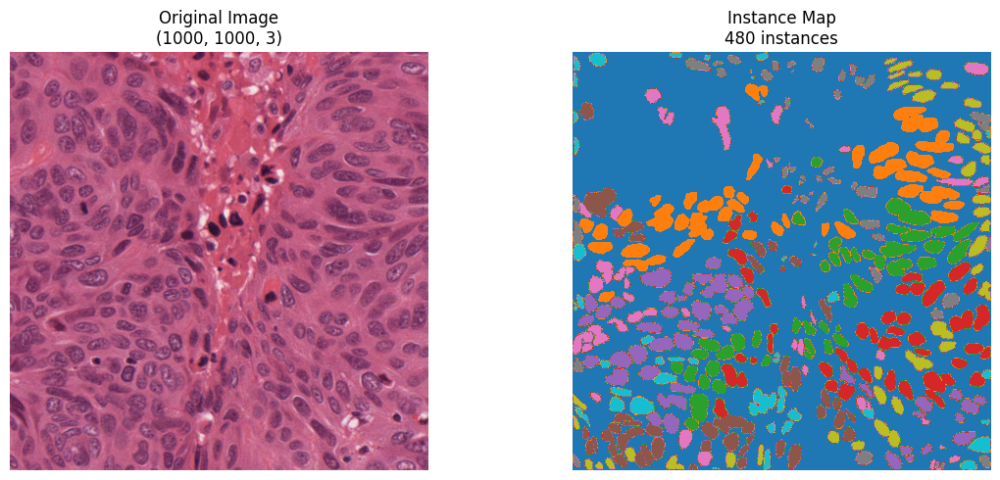


🔪 EXTRACTING PATCHES
💾 Saving patches to:
   - Images: monuseg/patches256x256_128/train/images
   - Instance maps: monuseg/patches256x256_128/train/instance_maps
   - Semantic maps: monuseg/patches256x256_128/train/semantic_maps


In [2]:
if len(images) > 0 and len(labels) > 0:
    # Show first image and label
    image = io.imread(images[0])
    label_mat = sio.loadmat(labels[0])
    inst_map = label_mat['inst_map']
    
    print(f"   - Image shape: {image.shape}")
    print(f"   - Instance map shape: {inst_map.shape}")
    print(f"   - Unique instances: {len(np.unique(inst_map)) - 1}")
    
    # Visualize original data
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    ax1.imshow(image)
    ax1.set_title(f'Original Image\n{image.shape}')
    ax1.axis('off')
    
    ax2.imshow(inst_map, cmap='tab10')
    ax2.set_title(f'Instance Map\n{len(np.unique(inst_map))-1} instances')
    ax2.axis('off')
    
    plt.tight_layout()
    plt.show()

## Extract 256 patches from original images
print(f"\n🔪 EXTRACTING PATCHES")
print("="*50)

save_root = 'monuseg'
split = 'train'
patch_size = (256, 256)
step_size = 128
base_dir = f'{save_root}/patches{patch_size[0]}x{patch_size[1]}_{step_size}/{split}'
save_img = f'{base_dir}/images'
save_inst = f'{base_dir}/instance_maps'  # Fixed: consistent naming
save_sem = f'{base_dir}/semantic_maps'   # Fixed: consistent naming

os.makedirs(save_img, exist_ok=True)
os.makedirs(save_inst, exist_ok=True)
os.makedirs(save_sem, exist_ok=True)

print(f"💾 Saving patches to:")
print(f"   - Images: {save_img}")
print(f"   - Instance maps: {save_inst}")
print(f"   - Semantic maps: {save_sem}")


📄 Processing: TCGA-18-5592-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 480
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-18-5592-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-18-5592-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-18-5592-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-18-5592-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

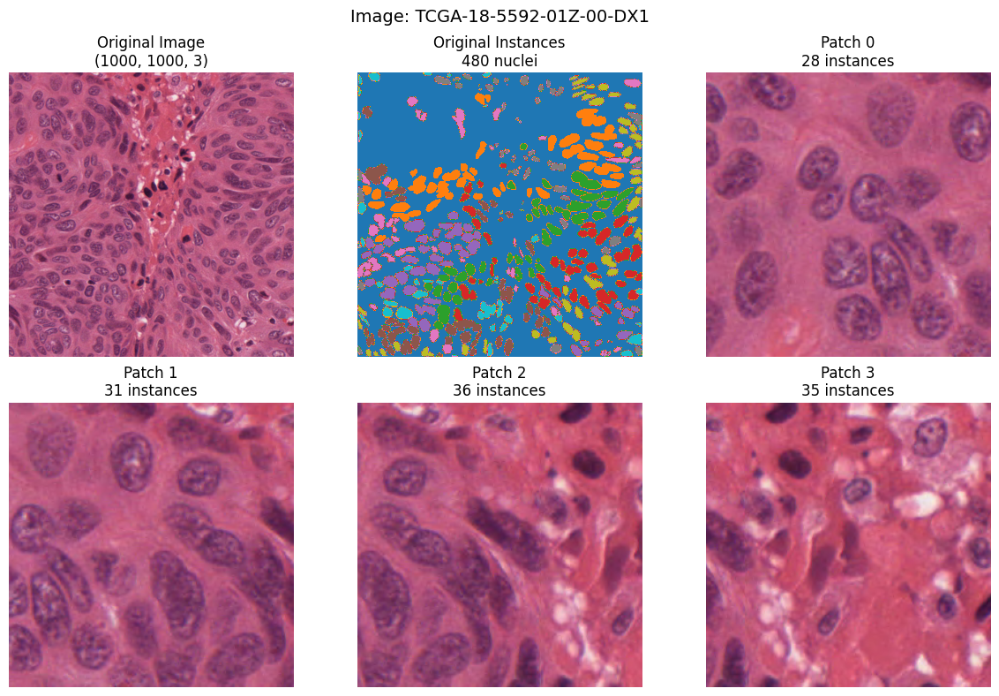

   ✅ Completed 1/16

📄 Processing: TCGA-38-6178-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 424
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-38-6178-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-38-6178-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-38-6178-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-38-6178-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

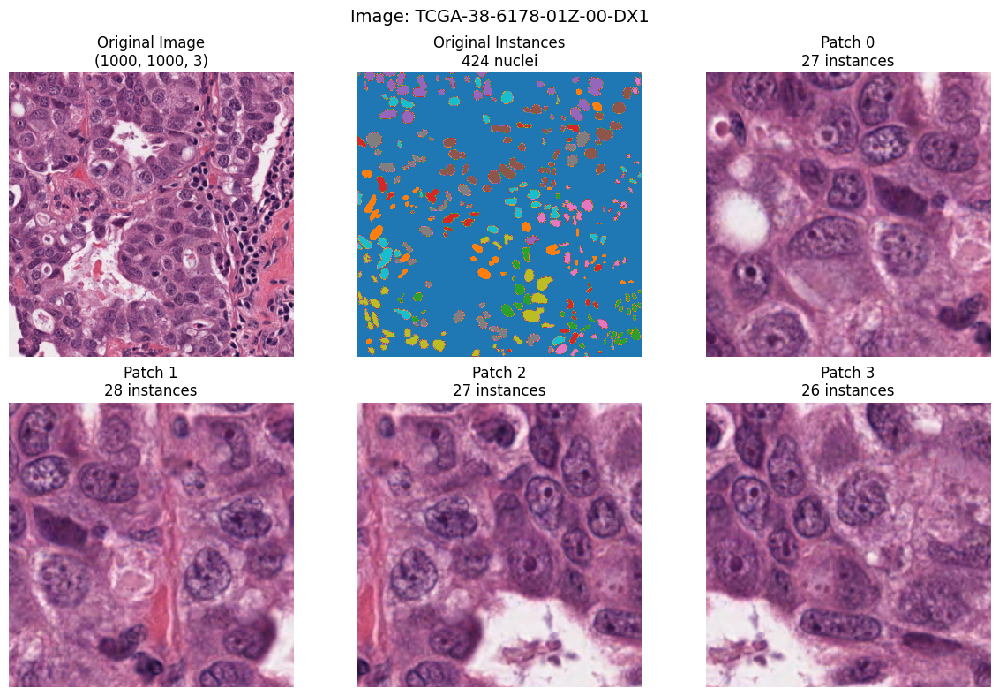

   ✅ Completed 2/16

📄 Processing: TCGA-49-4488-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 557
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-49-4488-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-49-4488-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-49-4488-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-49-4488-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

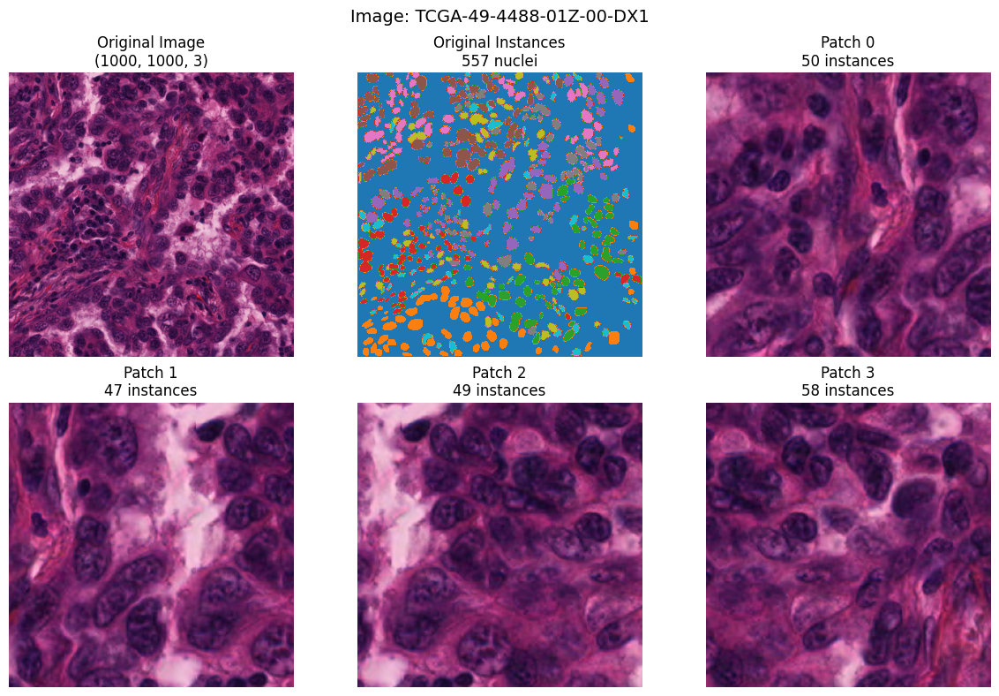

   ✅ Completed 3/16

📄 Processing: TCGA-50-5931-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 444
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-50-5931-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-50-5931-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-50-5931-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-50-5931-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

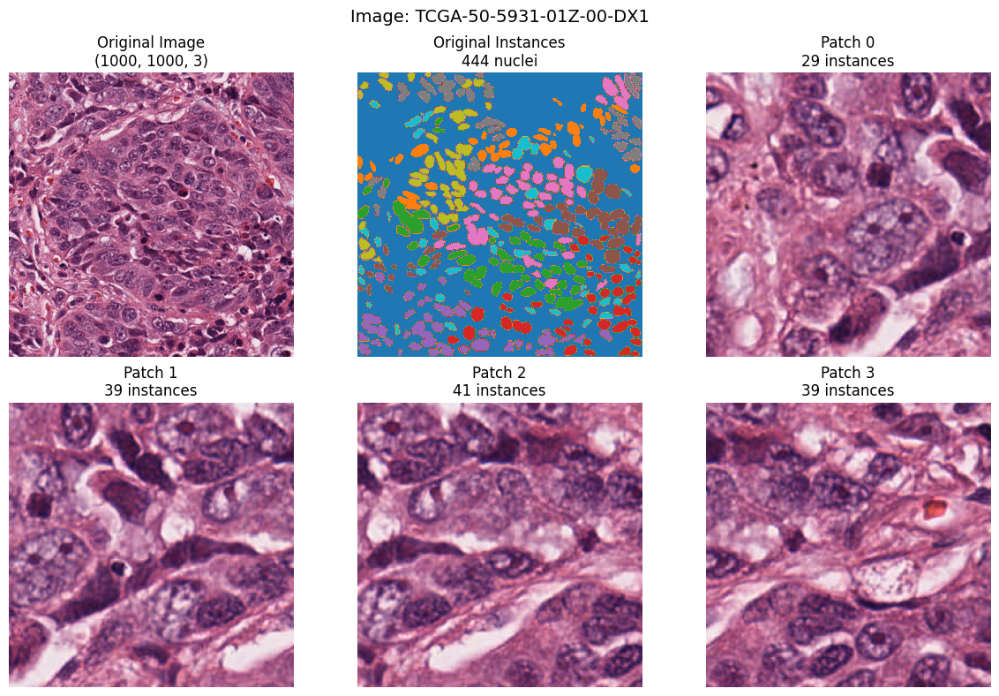

   ✅ Completed 4/16

📄 Processing: TCGA-A7-A13E-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 314
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13E-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13E-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13E-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13E-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

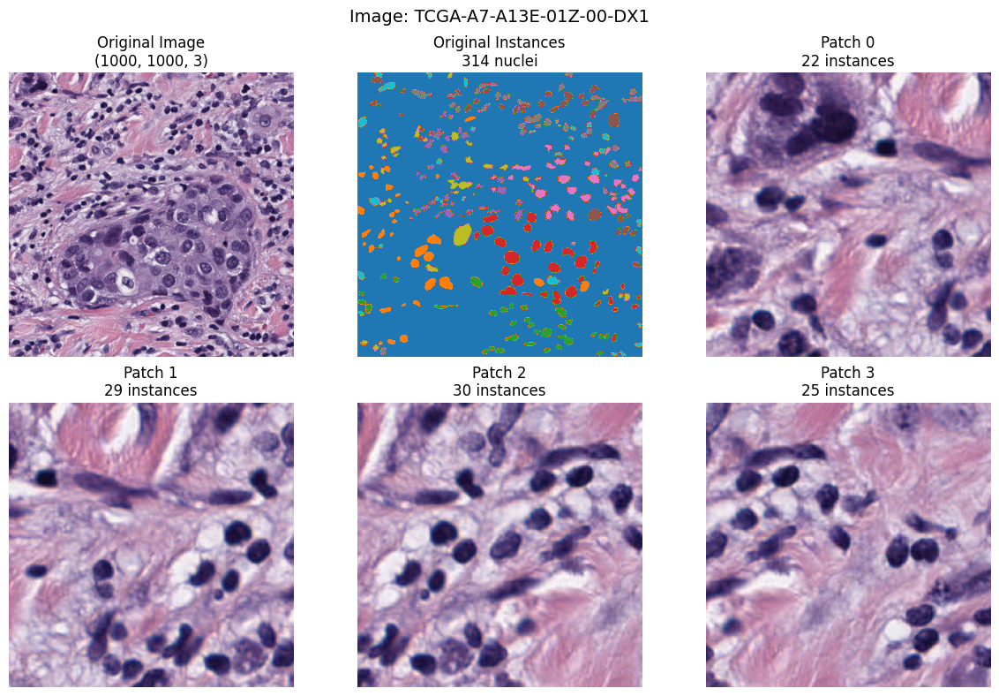

   ✅ Completed 5/16

📄 Processing: TCGA-A7-A13F-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 356
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13F-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13F-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13F-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-A7-A13F-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

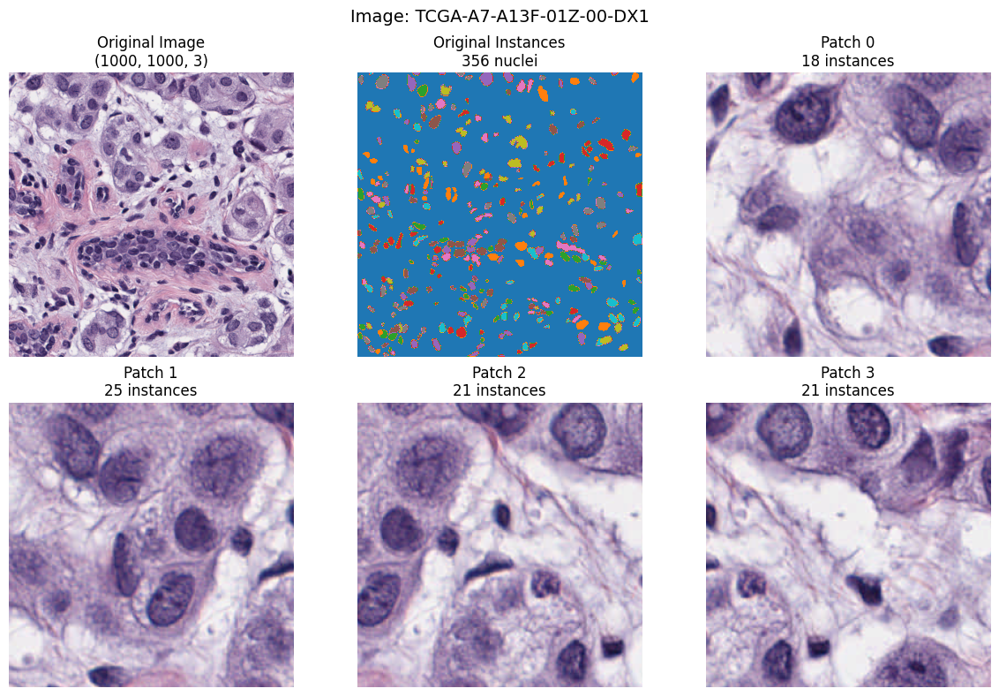

   ✅ Completed 6/16

📄 Processing: TCGA-AR-A1AK-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 432
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AK-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AK-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AK-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AK-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

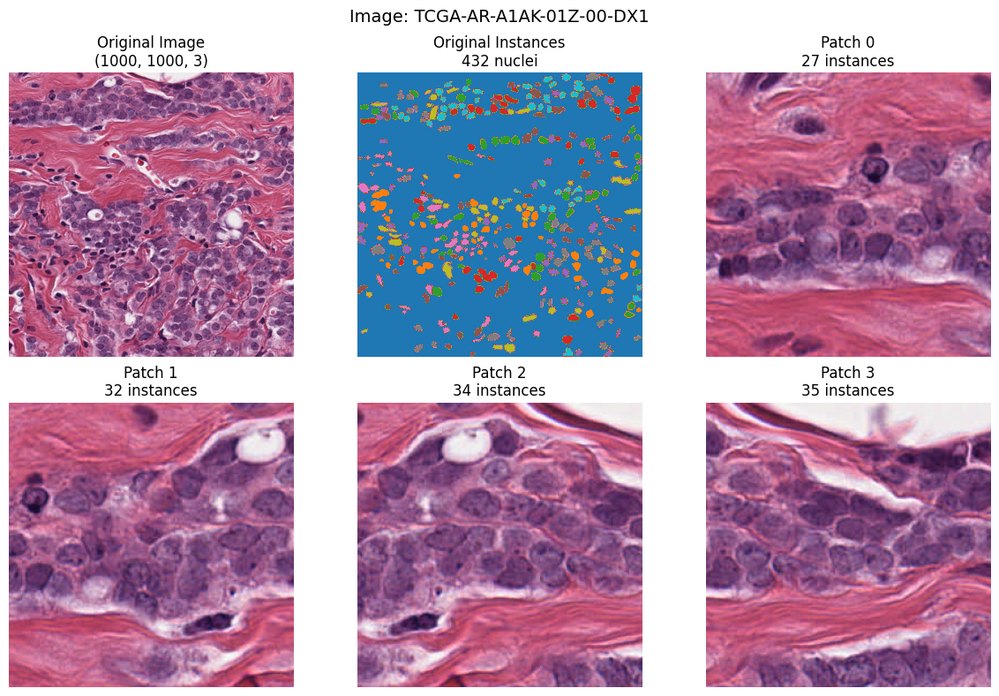

   ✅ Completed 7/16

📄 Processing: TCGA-AR-A1AS-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 405
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AS-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AS-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AS-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-AR-A1AS-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

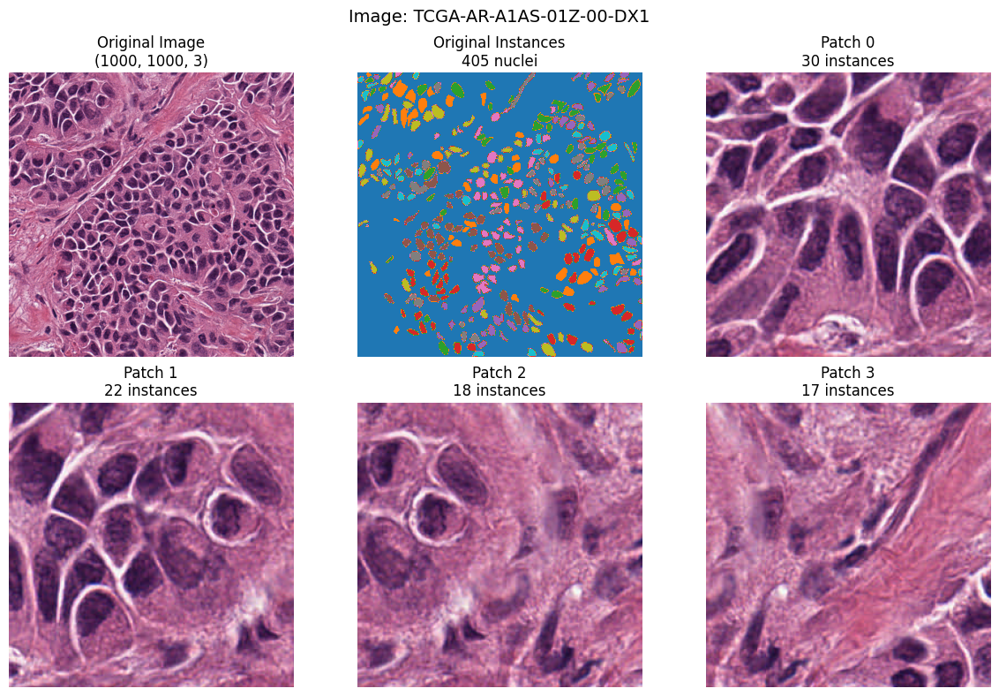

   ✅ Completed 8/16

📄 Processing: TCGA-B0-5711-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 342
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-B0-5711-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-B0-5711-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-B0-5711-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-B0-5711-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

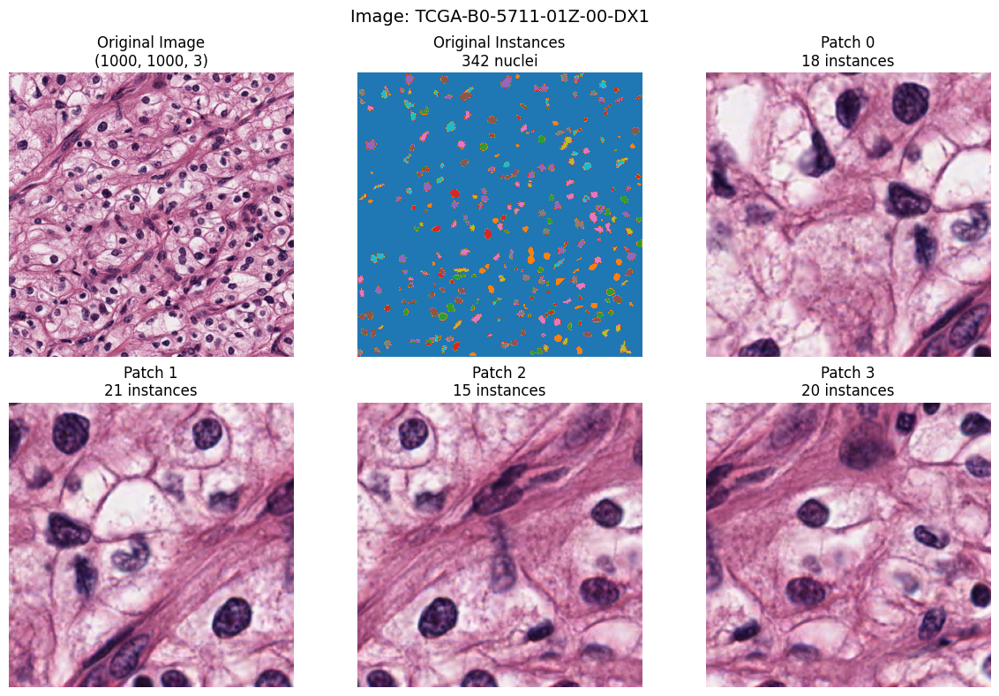

   ✅ Completed 9/16

📄 Processing: TCGA-G9-6336-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 448
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6336-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6336-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6336-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6336-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

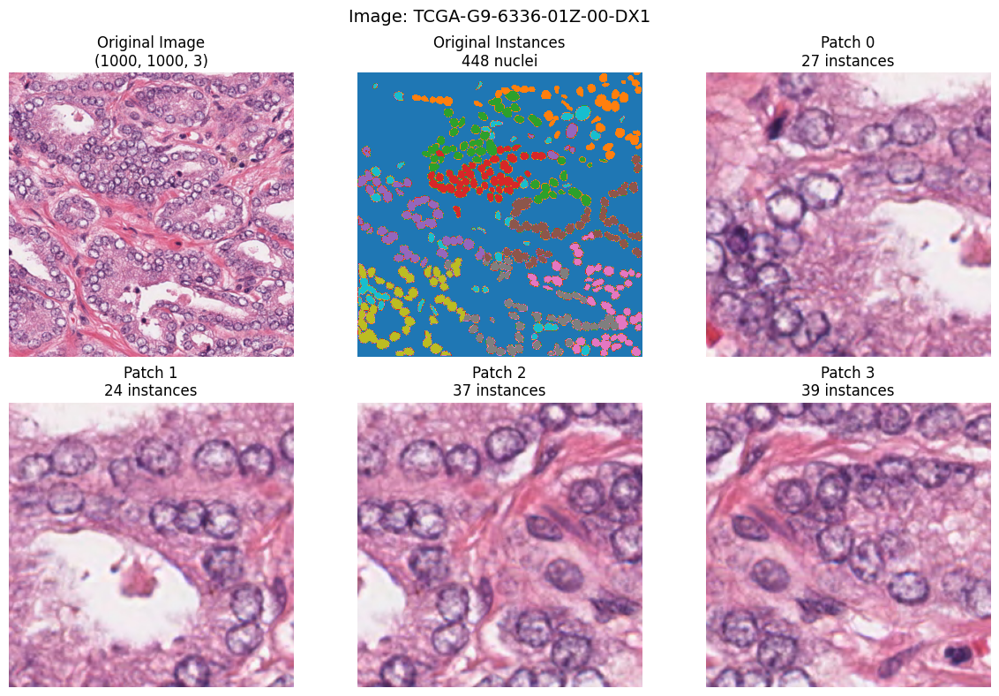

   ✅ Completed 10/16

📄 Processing: TCGA-G9-6348-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 390
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6348-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6348-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6348-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6348-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

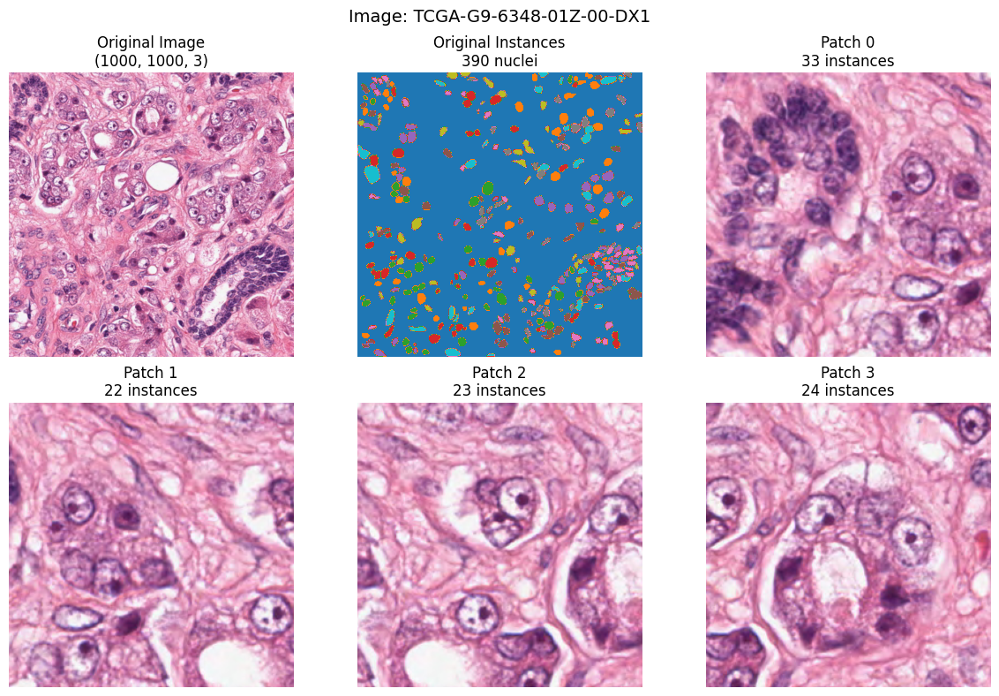

   ✅ Completed 11/16

📄 Processing: TCGA-G9-6356-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 442
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6356-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6356-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6356-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6356-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

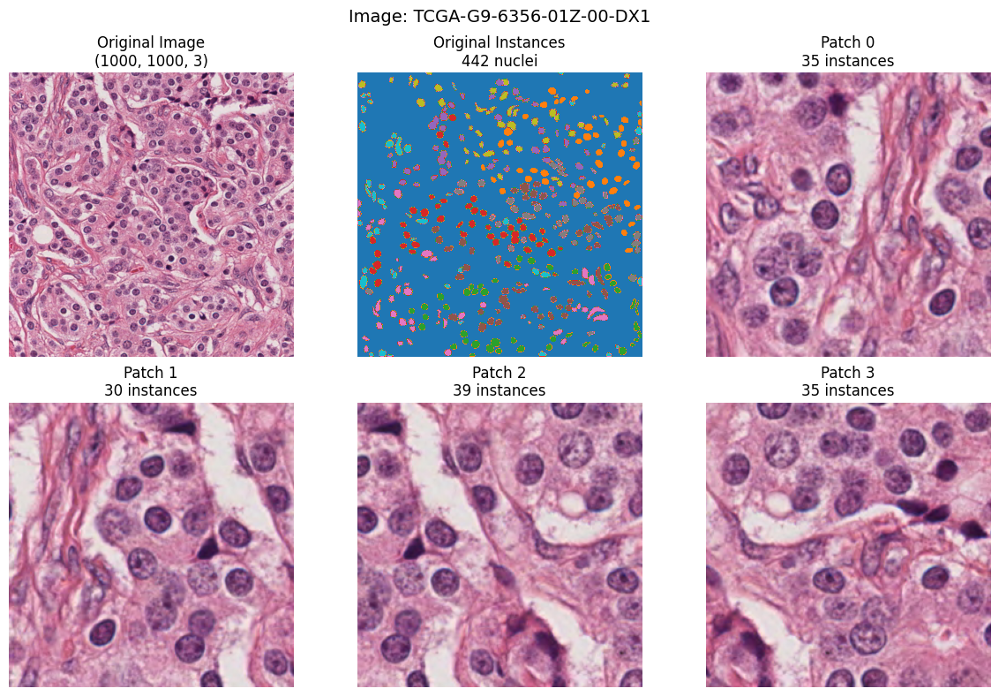

   ✅ Completed 12/16

📄 Processing: TCGA-G9-6363-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 354
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6363-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6363-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6363-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-G9-6363-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

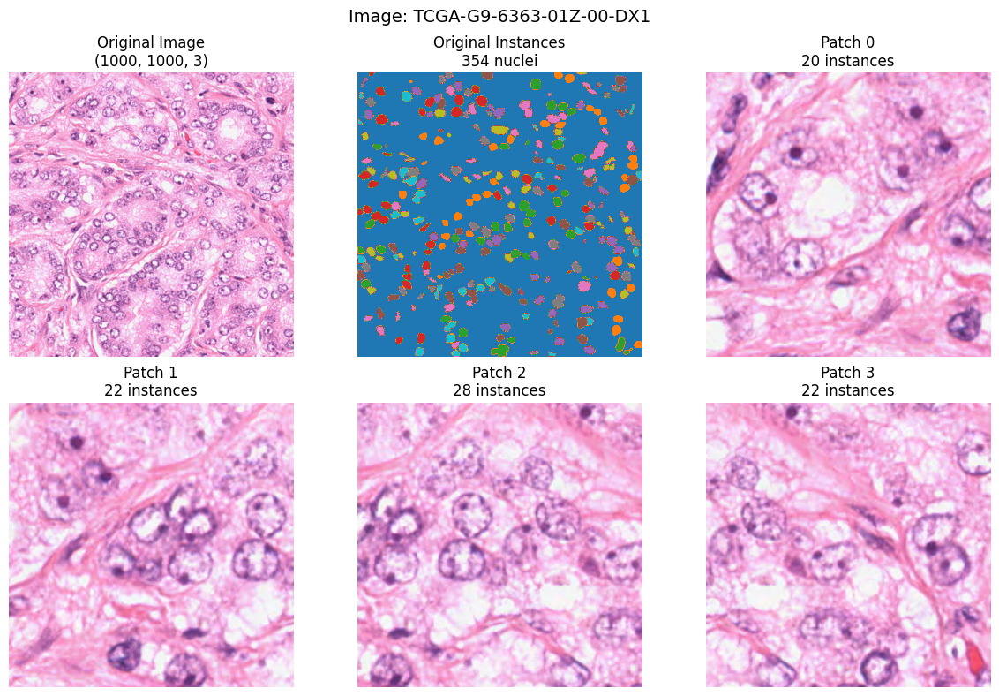

   ✅ Completed 13/16

📄 Processing: TCGA-HE-7128-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 1073
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7128-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7128-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7128-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7128-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

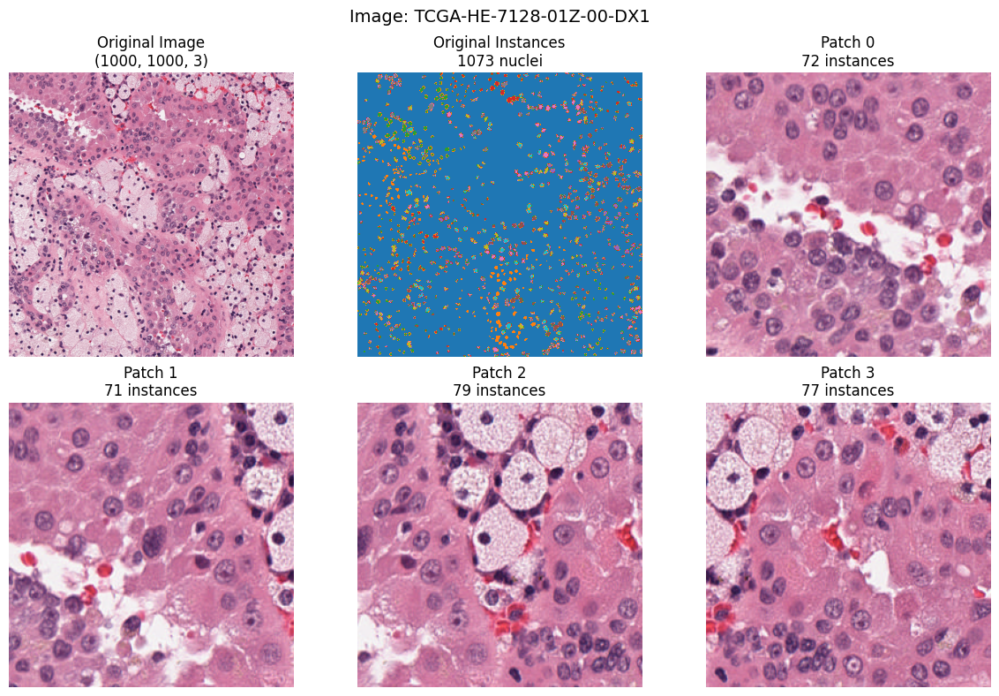

   ✅ Completed 14/16

📄 Processing: TCGA-HE-7129-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 1584
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7129-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7129-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7129-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7129-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

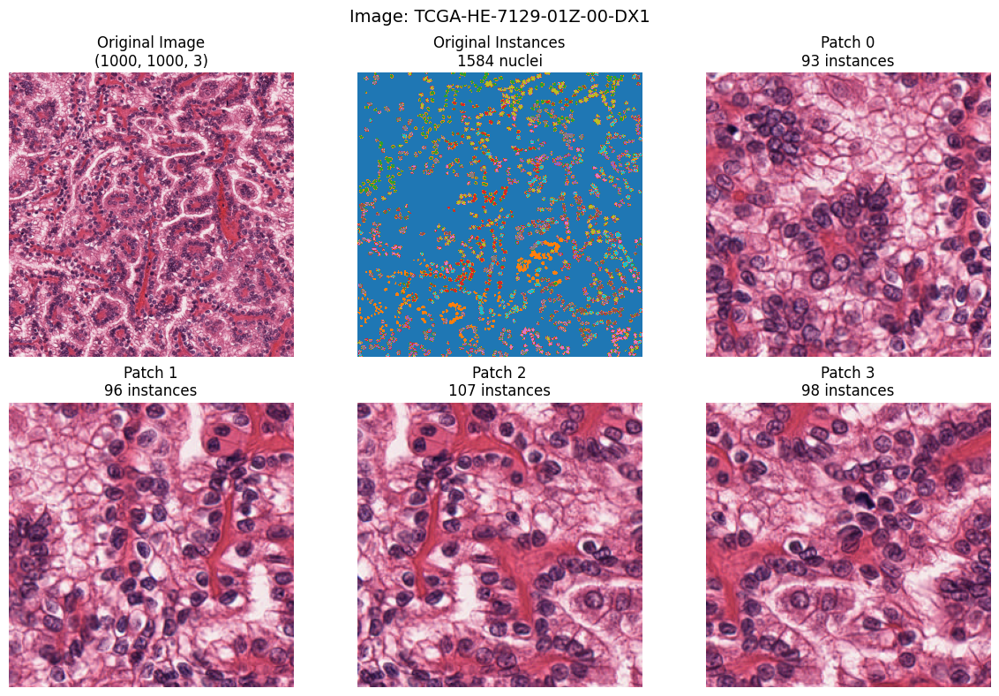

   ✅ Completed 15/16

📄 Processing: TCGA-HE-7130-01Z-00-DX1
   Image: (1000, 1000, 3), Instances: 1862
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Original image: 1000x1000
   Patch size: 256x256, Step: 128
   Grid: 6x6, Remainder flags: H:True, W:True
   Total patches extracted: 49
   Selected: 49/49 patches


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7130-01Z-00-DX1_0.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7130-01Z-00-DX1_1.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7130-01Z-00-DX1_2.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: monuseg/patches256x256_128/train/instance_maps/TCGA-HE-7130-01Z-00-DX1_3.tif is a low contrast image
  io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2896\3776696373.py:34: UserWarning: m

In [ ]:
all_patches = []  # Store all patches for later visualization

for n, (f1, f2) in enumerate(zip(images, labels)):
    name = os.path.basename(f1).split('.')[0]
    image = io.imread(f1)
    try:
        label = sio.loadmat(f2)
        inst_map = label['inst_map']
    except Exception as e:
        print(f'❌ Error loading {f2}: {e}')
        continue
    
    print(f'\n📄 Processing: {name}')
    print(f'   Image: {image.shape}, Instances: {len(np.unique(inst_map))-1}')
    
    patches_ = extract_patches(image, patch_size, step_size)
    inst_maps_ = extract_patches(inst_map, patch_size, step_size)
    
    # Store patches for visualization
    all_patches.extend(patches_)
    
    # Select patches (currently selecting all)
    sel_ids = list(range(len(patches_)))
    patches = [patches_[i] for i in sel_ids]
    inst_maps = [inst_maps_[i] for i in sel_ids]
    sem_maps = [semantic_map(inst_map) for inst_map in inst_maps]
    
    print(f'   Selected: {len(sel_ids)}/{len(inst_maps_)} patches')
    
    # Save patches
    for k, patch in enumerate(patches):
        io.imsave(f'{save_img}/{name}_{k}.png', patch)
    for k, patch in enumerate(inst_maps):
        io.imsave(f'{save_inst}/{name}_{k}.tif', patch)
    for k, patch in enumerate(sem_maps):
        io.imsave(f'{save_sem}/{name}_{k}.png', patch)
    
    # Show sample patches from this image
    if len(patches) > 0:
        fig, axes = plt.subplots(2, 3, figsize=(12, 8))
        axes = axes.ravel()
        
        # Original image and instance map
        axes[0].imshow(image)
        axes[0].set_title(f'Original Image\n{image.shape}')
        axes[0].axis('off')
        
        axes[1].imshow(inst_map, cmap='tab10')
        axes[1].set_title(f'Original Instances\n{len(np.unique(inst_map))-1} nuclei')
        axes[1].axis('off')
        
        # Sample patches
        for i in range(4):
            if i < len(patches):
                axes[i+2].imshow(patches[i])
                instances = len(np.unique(inst_maps[i])) - 1
                axes[i+2].set_title(f'Patch {i}\n{instances} instances')
                axes[i+2].axis('off')
        
        plt.suptitle(f'Image: {name}', fontsize=14)
        plt.tight_layout()
        plt.show()
    
    print(f'   ✅ Completed {n+1}/{len(images)}')

In [ ]:

print(f"\n🎯 STARTING FEATURE EXTRACTION AND CLUSTERING")
print("="*50)

## Model setup
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
print(f"🖥️  Using device: {device}")

resnet = models.resnet50(pretrained=True)
modules = list(resnet.children())[:-1]     
model = nn.Sequential(*modules)
model.eval()
model.to(device)

print("✅ ResNet50 feature extractor loaded")


🎯 STARTING FEATURE EXTRACTION AND CLUSTERING
🖥️  Using device: cuda:0


c:\Users\ASUS\miniconda3\envs\nudiff\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\ASUS\miniconda3\envs\nudiff\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


✅ ResNet50 feature extractor loaded


In [ ]:
## Dataset preparation
resnet_transform = transforms.Compose([
    transforms.Resize(size=256),
    transforms.CenterCrop(size=224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

img_dir = f'{save_root}/patches{patch_size[0]}x{patch_size[1]}_{step_size}/{split}/images'
label_dir = f'{save_root}/patches{patch_size[0]}x{patch_size[1]}_{step_size}/{split}/instance_maps'

print(f"\n📂 Loading patches from:")
print(f"   - Images: {img_dir}")
print(f"   - Labels: {label_dir}")

dataset = ClusterDataset(img_dir, label_dir, transform=resnet_transform)
loader = DataLoader(dataset, batch_size=49, shuffle=False)

print(f"📦 Dataset size: {len(dataset)} patches")

## Feature extraction
print(f"\n🔍 EXTRACTING FEATURES...")
features, labels, n_uniques, img_paths = [], [], [], []

for i, (batch, label, n_unique, path) in enumerate(tqdm(loader, desc="Extracting features")):
    batch = batch.to(device)
    with torch.no_grad():
        feature = model(batch)
    features.append(feature.detach().cpu().numpy().squeeze())
    labels.append(label.detach().numpy())
    n_uniques.extend(n_unique.tolist())
    img_paths.extend(list(path))

features = np.concatenate(features, axis=0)
labels = np.concatenate(labels, axis=0)
n_uniques = np.array(n_uniques)
img_paths = np.array(img_paths)

print(f"✅ Feature extraction completed:")
print(f"   - Feature shape: {features.shape}")
print(f"   - Unique instances distribution:")
print(f"     Min: {n_uniques.min()}, Max: {n_uniques.max()}, Mean: {n_uniques.mean():.2f}")



📂 Loading patches from:
   - Images: monuseg/patches256x256_128/train/images
   - Labels: monuseg/patches256x256_128/train/instance_maps

📁 Dataset Initialized:
   - Images: 784 files
   - Labels: 784 files
   - Sample image: monuseg/patches256x256_128/train/images\TCGA-18-5592-01Z-00-DX1_0.png
📦 Dataset size: 784 patches

🔍 EXTRACTING FEATURES...


Extracting features: 100%|██████████| 16/16 [00:32<00:00,  2.01s/it]

✅ Feature extraction completed:
   - Feature shape: (784, 2048)
   - Unique instances distribution:
     Min: 11, Max: 238, Mean: 48.03


In [ ]:
## Clustering
print(f"\n📊 PERFORMING CLUSTERING...")
K = 6
kmeans = KMeans(init="random", n_clusters=K, random_state=42, n_init=10)

t0 = time.time()
kmeans.fit(features)
clustering_time = time.time() - t0

p_labels = kmeans.labels_

print(f"✅ Clustering completed in {clustering_time:.2f}s")
print(f"   - Number of clusters: {K}")
print(f"   - Cluster distribution: {np.bincount(p_labels)}")

## Select patches close to cluster centers
print(f"\n🎯 SELECTING PATCHES NEAR CLUSTER CENTERS...")

# Dynamically calculate chunks based on actual dataset size
dataset_size = len(dataset)
chunk_size = max(1, dataset_size // 30)
chunks = np.split(np.arange(dataset_size), range(chunk_size, dataset_size, chunk_size))

prop = 1.0  # Adjust this for different subset sizes
props = [prop] * K
selected_ids = dict.fromkeys(list(range(K)))
all_ids = dict.fromkeys(list(range(K)))
inst_percents, inst_numbers, total_inst_number = [], [], 0

print(f"   Using selection proportion: {prop}")
print(f"   Dataset divided into {len(chunks)} chunks")

c:\Users\ASUS\miniconda3\envs\nudiff\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\ASUS\miniconda3\envs\nudiff\lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
  File "c:\Users\ASUS\miniconda3\envs\nudiff\lib\subprocess.py", line 493, in run
    with Popen(*popenargs, **kwargs) as process:
  File "c:\Users\ASUS\miniconda3\envs\nudiff\lib\subprocess.py", line 858, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "c:\Users\ASUS\miniconda3\envs\nudiff\lib\subprocess.py", line 1327, in _execute_child
    hp, ht, pid, tid = _winapi.CreateProcess(exec


📊 PERFORMING CLUSTERING...
✅ Clustering completed in 0.29s
   - Number of clusters: 6
   - Cluster distribution: [116  71 180 187  50 180]

🎯 SELECTING PATCHES NEAR CLUSTER CENTERS...
   Using selection proportion: 1.0
   Dataset divided into 31 chunks


In [ ]:
for k in tqdm(range(K), desc="Processing clusters"):
    print(f"\n   🔍 Cluster {k}:")
    
    # Get distances to cluster center
    cluster_mask = p_labels == k
    cluster_features = features[cluster_mask]
    cluster_ids = np.where(cluster_mask)[0]
    
    distances = pairwise_distances(
        kmeans.cluster_centers_[k][None, :], 
        cluster_features
    ).squeeze()
    
    # Select closest patches
    n_close = int(len(cluster_ids) * props[k])
    close_ids = cluster_ids[np.argsort(distances)[:n_close]]
    
    print(f"     - Total patches: {len(cluster_ids)}")
    print(f"     - Selected patches: {len(close_ids)}")
    print(f"     - Distance stats: min={distances.min():.3f}, "
          f"max={distances.max():.3f}, mean={distances.mean():.3f}")
    
    # Calculate instance statistics
    close_unions, cluster_unions = [], []
    
    for chunk in chunks:
        chunk_ids = [x for x in cluster_ids if x in chunk]
        if len(chunk_ids) > 0:
            # Flatten all instance maps in this chunk and count unique instances
            all_instances = []
            for idx in chunk_ids:
                all_instances.extend(np.unique(labels[idx]).tolist())
            cluster_unions.append(len(np.unique(all_instances)))
    
    for chunk in chunks:
        chunk_ids = [x for x in close_ids if x in chunk]
        if len(chunk_ids) > 0:
            all_instances = []
            for idx in chunk_ids:
                all_instances.extend(np.unique(labels[idx]).tolist())
            close_unions.append(len(np.unique(all_instances)))
    
    if sum(cluster_unions) > 0:
        percent = sum(close_unions) / sum(cluster_unions)
    else:
        percent = 0
        
    inst_percents.append(percent)
    inst_numbers.append(sum(close_unions))
    total_inst_number += sum(cluster_unions)
    
    print(f"     - Instance preservation: {percent:.3f} "
          f"({sum(close_unions)}/{sum(cluster_unions)} instances)")
    
    selected_ids[k] = close_ids
    all_ids[k] = cluster_ids

Processing clusters:  17%|█▋        | 1/6 [00:00<00:00,  6.99it/s]


   🔍 Cluster 0:
     - Total patches: 116
     - Selected patches: 116
     - Distance stats: min=6.739, max=18.839, mean=10.894
     - Instance preservation: 1.000 (1878/1878 instances)

   🔍 Cluster 1:
     - Total patches: 71
     - Selected patches: 71
     - Distance stats: min=5.133, max=11.396, mean=8.409


Processing clusters:  50%|█████     | 3/6 [00:00<00:00,  6.94it/s]

     - Instance preservation: 1.000 (3151/3151 instances)

   🔍 Cluster 2:
     - Total patches: 180
     - Selected patches: 180
     - Distance stats: min=5.868, max=19.508, mean=9.177
     - Instance preservation: 1.000 (2649/2649 instances)

   🔍 Cluster 3:
     - Total patches: 187
     - Selected patches: 187
     - Distance stats: min=6.934, max=13.494, mean=9.425


Processing clusters:  67%|██████▋   | 4/6 [00:00<00:00,  5.59it/s]

     - Instance preservation: 1.000 (4362/4362 instances)

   🔍 Cluster 4:
     - Total patches: 50
     - Selected patches: 50
     - Distance stats: min=5.182, max=12.126, mean=6.993
     - Instance preservation: 1.000 (2414/2414 instances)

   🔍 Cluster 5:
     - Total patches: 180
     - Selected patches: 180
     - Distance stats: min=7.466, max=17.407, mean=10.596


Processing clusters: 100%|██████████| 6/6 [00:00<00:00,  6.41it/s]

     - Instance preservation: 1.000 (2520/2520 instances)



📈 GLOBAL RESULTS:
   - Global instance preservation: 1.000
   - Total instances in selected set: 16974
   - Total instances in full set: 16974

📊 GENERATING COMPREHENSIVE VISUALIZATIONS...


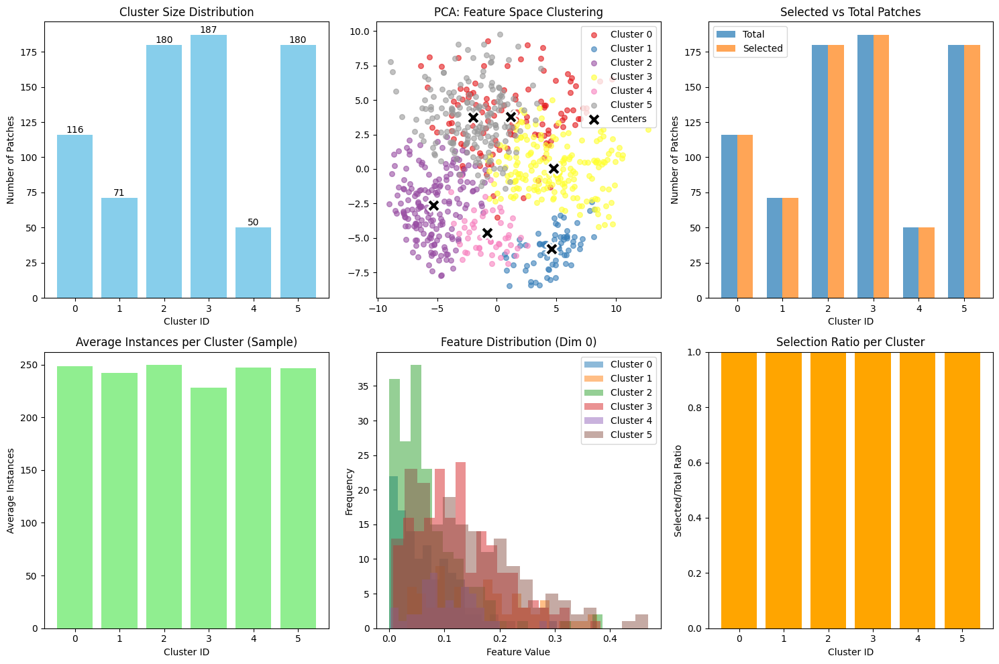


SAMPLE PATCHES FROM EACH CLUSTER


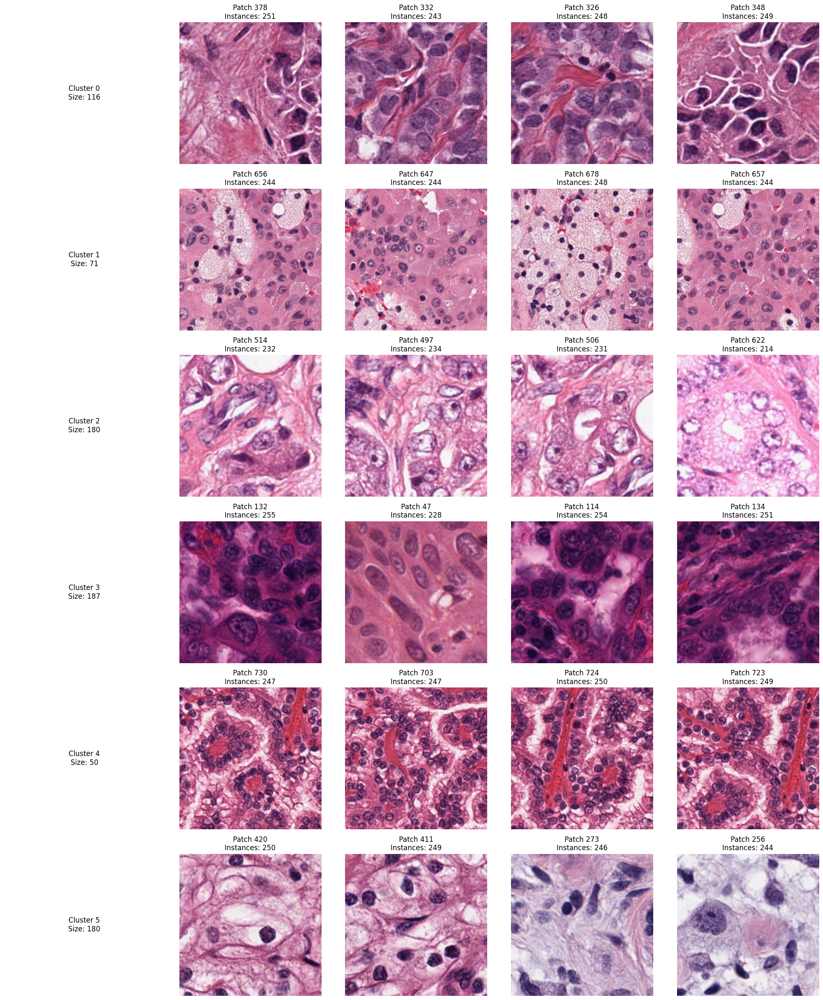


💾 SAVING SELECTED PATCHES...
   Saving to: monuseg/patches256x256_128/train_6class_prop1.00


In [ ]:
global_percent = sum(inst_numbers) / total_inst_number if total_inst_number > 0 else 0

print(f"\n📈 GLOBAL RESULTS:")
print(f"   - Global instance preservation: {global_percent:.3f}")
print(f"   - Total instances in selected set: {sum(inst_numbers)}")
print(f"   - Total instances in full set: {total_inst_number}")

# Enhanced visualization
print(f"\n📊 GENERATING COMPREHENSIVE VISUALIZATIONS...")
visualize_cluster_results(features, p_labels, kmeans, selected_ids, img_paths, all_patches, K)

## Save selected patches
print(f"\n💾 SAVING SELECTED PATCHES...")
save_dir = f'{save_root}/patches{patch_size[0]}x{patch_size[1]}_{step_size}/train_6class_prop{global_percent:.2f}'
os.makedirs(save_dir, exist_ok=True)
os.makedirs(f'{save_dir}/images', exist_ok=True)
os.makedirs(f'{save_dir}/instance_maps', exist_ok=True)
os.makedirs(f'{save_dir}/semantic_maps', exist_ok=True)

print(f"   Saving to: {save_dir}")


In [ ]:
total_saved = 0
for k in range(K):
    print(f"   Saving cluster {k} ({len(selected_ids[k])} patches)...")
    for path in tqdm(img_paths[selected_ids[k]], desc=f"Cluster {k}"):
        name = os.path.basename(path).split('.')[0]
        
        # Copy files
        shutil.copy(path, f'{save_dir}/images/{name}.png')
        
        src_inst = f'{save_root}/patches{patch_size[0]}x{patch_size[1]}_{step_size}/{split}/instance_maps/{name}.tif'
        dst_inst = f'{save_dir}/instance_maps/{name}.tif'
        shutil.copy(src_inst, dst_inst)
        
        src_sem = f'{save_root}/patches{patch_size[0]}x{patch_size[1]}_{step_size}/{split}/semantic_maps/{name}.png'
        dst_sem = f'{save_dir}/semantic_maps/{name}.png'
        shutil.copy(src_sem, dst_sem)
        
        total_saved += 1

print(f"\n✅ PIPELINE COMPLETED SUCCESSFULLY!")
print(f"📊 FINAL SUMMARY:")
print(f"   - Total patches processed: {len(dataset)}")
print(f"   - Total patches selected: {total_saved}")
print(f"   - Instance preservation: {global_percent:.3f}")
print(f"   - Output directory: {save_dir}")
print("="*80)

   Saving cluster 0 (116 patches)...


Cluster 0: 100%|██████████| 116/116 [00:00<00:00, 188.40it/s]


   Saving cluster 1 (71 patches)...


Cluster 1: 100%|██████████| 71/71 [00:00<00:00, 258.36it/s]


   Saving cluster 2 (180 patches)...


Cluster 2: 100%|██████████| 180/180 [00:00<00:00, 245.76it/s]


   Saving cluster 3 (187 patches)...


Cluster 3: 100%|██████████| 187/187 [00:01<00:00, 169.97it/s]


   Saving cluster 4 (50 patches)...


Cluster 4: 100%|██████████| 50/50 [00:00<00:00, 262.83it/s]


   Saving cluster 5 (180 patches)...


Cluster 5: 100%|██████████| 180/180 [00:01<00:00, 177.04it/s]


✅ PIPELINE COMPLETED SUCCESSFULLY!
📊 FINAL SUMMARY:
   - Total patches processed: 784
   - Total patches selected: 784
   - Instance preservation: 1.000
   - Output directory: monuseg/patches256x256_128/train_6class_prop1.00


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


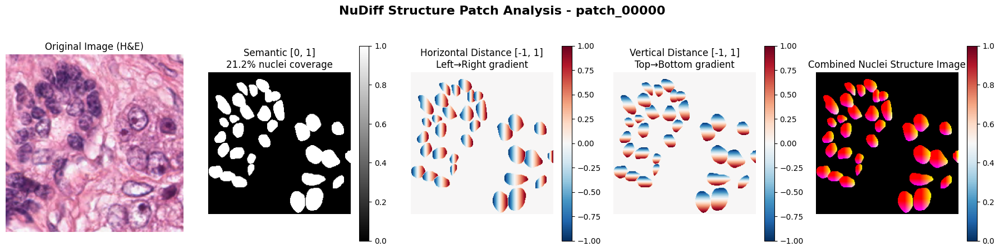

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from scipy import ndimage
from scipy.ndimage import measurements
from skimage import morphology

# Import từ datasets.py để tạo bản đồ 3 kênh
from nudiff.struct_syn.datasets import get_hv

def instance_to_structure(instance_map):
    """
    Convert instance map to nuclei structure [semantic, h_dist, v_dist]
    Based on nuclei_data_prep.py logic
    """
    # Semantic map: binary mask where nuclei exist
    semantic = (instance_map > 0).astype(np.uint8)
    
    # Horizontal/vertical distance transforms from nucleus centroids
    hv_map = get_hv(instance_map).astype(np.float32)
    
    # Combine into 3-channel structure
    structure = np.stack([semantic, hv_map[..., 0], hv_map[..., 1]], axis=-1)
    
    return structure

# Load data
import numpy as np
inst_map = np.load(
    'monuseg/patches256x256_128/train_10pct/instances/patch_00000.npy'
)
img = cv2.imread('monuseg/patches256x256_128/train_10pct/images/patch_00000.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

structure = instance_to_structure(inst_map)
sem = structure[..., 0]
h_dist = structure[..., 1]
v_dist = structure[..., 2]

# Create detailed analysis figure
fig = plt.figure(figsize=(18, 12))

# Row 1: Visual representation
ax1 = plt.subplot(3, 5, 1)
ax1.imshow(img)
ax1.set_title('Original Image (H&E)')
ax1.axis('off')

ax2 = plt.subplot(3, 5, 2)
im2 = ax2.imshow(sem, cmap='gray', vmin=0, vmax=1)
ax2.set_title('Semantic [0, 1]\n21.2% nuclei coverage')
ax2.axis('off')
plt.colorbar(im2, ax=ax2)

ax3 = plt.subplot(3, 5, 3)
im3 = ax3.imshow(h_dist, cmap='RdBu_r', vmin=-1, vmax=1)
ax3.set_title('Horizontal Distance [-1, 1]\nLeft→Right gradient')
ax3.axis('off')
plt.colorbar(im3, ax=ax3)

ax4 = plt.subplot(3, 5, 4)
im4 = ax4.imshow(v_dist, cmap='RdBu_r', vmin=-1, vmax=1)
ax4.set_title('Vertical Distance [-1, 1]\nTop→Bottom gradient')
ax4.axis('off')
plt.colorbar(im4, ax=ax4)

ax5 = plt.subplot(3,5,5)
im5 = ax5.imshow(structure, cmap='RdBu_r')
ax5.set_title('Combined Nuclei Structure Image')
ax5.axis('off')
plt.colorbar(im5, ax=ax5)

plt.suptitle('NuDiff Structure Patch Analysis - patch_00000', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()


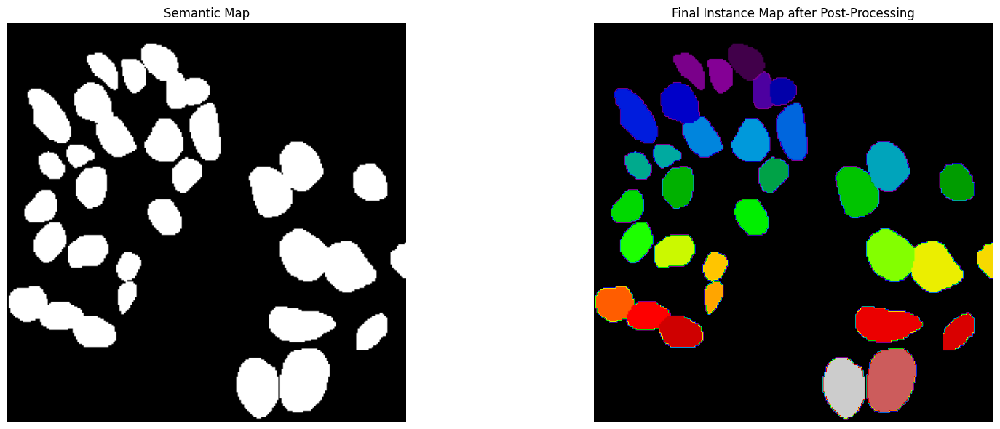

In [ ]:
import nudiff.struct_syn.utils.post_proc as pp

# Tạo prediction map 3-channel
pred = np.stack([sem, h_dist, v_dist], axis=-1).astype(np.float32)
pred[:,:,1:] = pred[:,:,1:] * 2 - 1  # scale HV to [-1, 1]

# Chạy post-processing
final_proced_pred = pp.proc_np_hv(pred)

# Visualize
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

axes[0].imshow(sem, cmap='gray')
axes[0].set_title('Semantic Map')
axes[0].axis('off')

axes[1].imshow(final_proced_pred, cmap='nipy_spectral')
axes[1].set_title('Final Instance Map after Post-Processing')
axes[1].axis('off')

# Optional: nếu muốn xem marker / bước trung gian
# axes[2].imshow(proced_pred, cmap='nipy_spectral')
# axes[2].set_title('Intermediate Step')
# axes[2].axis('off')

plt.tight_layout()
plt.show()
